# Mapping Coastal Building Footprints

This notebook was written for the CoCliCo meet-up in Orléans,  October 2022, to demonstrate the CoCliCo STAC API Demonstration. 

The purpose of this notebook is to provide an example of how data that is available in the CoCliCo STAC catalog can be combined with data from other parties to do cloud-based data analysis.

In this dataset we combine the coastal mask (Daniel Lincke, WCF, 2022) with buildings footprints [dataset](https://github.com/microsoft/GlobalMLBuildingFootprints) from Microsoft for The Netherlands.

In [1]:
import os
import pathlib
import sys

# make coclico library importable by appending src from project root to path
cwd = pathlib.Path().resolve()
PROJ_ROOT = os.path.dirname(cwd)

sys.path.append(os.path.join(PROJ_ROOT, "src"))

## Python tools

Below we import some python packages that are often used when working with geospatial data that are hosted in the cloud. These libraries are listed a `environment.yml` file that is available in the root of coclico workbench repository. When the conda package manager is available on the machine (or better: mamba), a new environment with these packages can be created by running `conda create -n coclico -f environment.yml`

In [2]:
!cat "{PROJ_ROOT}/environment.yml"

channels:
  - conda-forge
  - nodefaults
dependencies:
  - python=3.10
  - ipykernel
  - nb_conda
  - jupyterlab
  - dask-labextension
  - jupyterlab_code_formatter
  - jupyterlab_vim # jupyterlab-contrib/jupyterlab-vim
  - jupyterlab-git
  - ipywidgets
  - geopandas
  - pygeos
  - pyogrio
  - dask
  - distributed
  - dask-geopandas
  - nodejs
  - xarray
  - netcdf4
  - numpy
  - pandas
  - matplotlib
  - folium
  - mapclassify
  - cartopy
  - contextily
  - pyarrow
  - rasterio
  - rioxarray
  - scipy
  - bandit
  - isort
  - black
  - zarr
  - h5py
  - fiona
  - geojson
  - pystac
  - pystac-client
  - python-dotenv
  - adlfs
  - gcsfs
  - tqdm
  - hvplot
  - datashader
  - geoviews
  - spatialpandas


In [3]:
import dask
import dask_geopandas
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pystac_client
import rasterio
import rioxarray
import shapely
import xarray as xr

## Connect to the coclico-stac catalog

The STAC catalog is currenlty hosted in our data bucket at https://storage.googleapis.com/dgds-data-public/coclico/coclico-stac/catalog.json. In future we could (and maybe should) move this to  https://coclicoservices.eu/api/stac/v1

With `pystac` the json files that describe the coclico data following STAC specifications can be read into a Python object that is browsable and searchable. 

In [4]:
catalog = pystac_client.Client.open(
    "https://storage.googleapis.com/dgds-data-public/coclico/coclico-stac/catalog.json"
)
catalog

ID: coclico-catalog
Description: CoCliCo Catalog
type: Catalog
ID: ssl
Title: Extreme surge level
"Description: Dataset with extreme Storm Surge Levels (SSL) at the European scale. SSL are estimated for three climate scenarios (Historical, RCP4.5 and RCP8.5) for eight return periods (5, 10, 20, 50, 100, 200, 500 and 1000) according to the Peak Over Threshold method. This dataset is part of the [LISCOAST](https://data.jrc.ec.europa.eu/collection/LISCOAST) project. See this [article](https://doi.org/10.1007/s00382-016-3019-5) for more dataset-specific information."
"Providers: Deltares (producer, processor): Deltares is an independent institute for applied research in the field of water and subsurface."
type: Collection
"stac_extensions: ['https://raw.githubusercontent.com/openearth/coclicodata/feat/update-deltares-stac-properties/json-schema/schema.json', 'https://stac-extensions.github.io/datacube/v2.0.0/schema.json']"
title: Extreme surge level
keywords: ['CoCliCo']


### Structure of STAC catalogues 

- Catalog: A STAC catalog is a top-level object that logically groups other Catalog, Collection, and item objects. 
- Collection: A STAC Collection provides additional information about a spatio-temporal collection of data. 
- Item: a STAC Item represents an atomic collection of inseparable data and metadata.
- Asset: Links to data. 

For more please refer to the [documentation](https://stacspec.org/en/about/stac-spec/)

## Browse the catalog

There are several methods to browse the STAC catalog. Noteworthy is the search method `catalog.search()`, which is able to search for bounding boxes or tags. When datasets are created by the provides they can provide a list of "tags" which can be added to the stac. In that way users can for example browse all datasets related to "sea-level-rise". 

In [5]:
# Here we just list all collections that are present in the catalog
list(catalog.get_children())

[<CollectionClient id=ssl>,
 <CollectionClient id=wef>,
 <CollectionClient id=eesl>,
 <CollectionClient id=floodmaps>,
 <CollectionClient id=sc>,
 <CollectionClient id=cbca>,
 <CollectionClient id=cfr>,
 <CollectionClient id=cm>,
 <CollectionClient id=ssl>,
 <CollectionClient id=wef>,
 <CollectionClient id=eesl>,
 <CollectionClient id=smd>,
 <CollectionClient id=sc>,
 <CollectionClient id=cm>,
 <CollectionClient id=cm>,
 <CollectionClient id=cm>]

### Get the items of a given dataset
Collections may include several items, for example, each representing one Cloud Optimized GeoTiff. Here we make a list of STAC items that are included in the Coastal Mask collection. 

In [6]:
# we can now browse the datasets by interacting with the STAC catalog
items = list(catalog.get_child("cm").get_all_items())

### What are STAC items?

Nothing more than text files describing what's in the data!

In [7]:
import sys

print(f"{sys.getsizeof(items[0].to_dict())} bytes")
items[0].to_dict()

360 bytes


{'type': 'Feature',
 'stac_version': '1.0.0',
 'id': 'cm-minx=3.31-miny=50.95',
 'properties': {'proj:bbox': [3.314583333333331,
   50.80291666666667,
   3.741249999999998,
   50.95041666666667],
  'proj:shape': [177, 512],
  'proj:epsg': 4326,
  'proj:geometry': {'type': 'Polygon',
   'coordinates': [[[3.741249999999998, 50.80291666666667],
     [3.741249999999998, 50.95041666666667],
     [3.314583333333331, 50.95041666666667],
     [3.314583333333331, 50.80291666666667],
     [3.741249999999998, 50.80291666666667]]]},
  'proj:transform': [0.0008333333333333343,
   0.0,
   3.314583333333331,
   0.0,
   -0.0008333333333333323,
   50.95041666666667],
  'datetime': '2000-01-01T00:00:00Z'},
 'geometry': {'type': 'Polygon',
  'coordinates': [[[3.741249999999998, 50.80291666666667],
    [3.741249999999998, 50.95041666666667],
    [3.314583333333331, 50.95041666666667],
    [3.314583333333331, 50.80291666666667],
    [3.741249999999998, 50.80291666666667]]]},
 'links': [{'rel': 'collection'

In [8]:
items[0].to_dict()["assets"]["cm"]["href"]

'https://storage.googleapis.com/dgds-data-public/coclico/coastal_mask/minx=3.31-miny=50.95.tif'

## Particular advantage of working with STAC: indexing datasets without having to read the data


The aim here is to retrieve a list of items that contain data of our region of interest. So first we have to define a region of interest 

In the cell below, we import a function from the coclico-workbench tools for creating a bounding box geometry, wrapped inside a GeoPandas GeoDataFrame. This geometry is created from a list of bbox coordinates (yuor ROI). 

Working with GeoPandas dataframes is often handy because the library provides spatial indices to the dataframe, thus, data can be accessed using rtree functionalities.  

In [9]:
from coclico.utils.geo import geo_bbox

roi = geo_bbox(
    [5.2774, 53.0838, 7.1232, 53.5638]
)  # rois can be drawn using for example https://boundingbox.klokantech.com/
roi.explore()

### Get the bounding box for each of the STAC items 

All the STAC items contain a property that describes the bounding bbox of the data. All these properties are converted to GeoPandas dataframes, which are concatenated into one dataframe.

This dataframe describes the spatial extent per bounding box. When the source data (`coastal_mask.tif`) was converted to Cloud Optimized GeoTiff's  we chose a size of 512 x 512 pixels. The coastal mask was derived from the SRTM Dem, so each pixel equivalents approximately 90 meters. Thus, one of these bounding boxes span an area of 45 x 45 km, although the outer boxes may contain less pixels.  

Note, here we construct the spatial extent from the STAC items by reading the bbox property in each item. In future, when search functions are implemenented, this will be even easier, as we can use the `pystac_client.Client().search()` method that can handle geometries such as bounding boxes. 

In [10]:
bboxes = pd.concat([geo_bbox(i.to_dict()["bbox"]) for i in items])
bboxes = bboxes.reset_index(drop=True)
bboxes.explore()

### Get items for region of interest

Suppose that only that from a certain region is required. In such scenario a bounding box of the region of interest (ROI) can be created using several gis tools, [also online](https://boundingbox.klokantech.com). With GeoPandas it is now easy to get the bboxes that match the ROI. 

In [11]:
bboxes_roi = gpd.sjoin(bboxes, roi)[bboxes.columns]
bboxes_roi.explore()

In [12]:
# obtain STAC items that cover the ROI
items_roi = [items[i] for i in bboxes_roi.index]

In [13]:
# inspect the first item
items_roi[0]

ID: cm-minx=5.02-miny=53.51
"Bounding Box: [5.02125, 53.08375, 5.447916666666666, 53.510416666666664]"
Datetime: 2000-01-01 00:00:00+00:00
"proj:bbox: [5.02125, 53.08375, 5.447916666666666, 53.510416666666664]"
"proj:shape: [512, 512]"
proj:epsg: 4326
"proj:geometry: {'type': 'Polygon', 'coordinates': [[[5.447916666666666, 53.08375], [5.447916666666666, 53.510416666666664], [5.02125, 53.510416666666664], [5.02125, 53.08375], [5.447916666666666, 53.08375]]]}"
"proj:transform: [0.0008333333333333343, 0.0, 5.02125, 0.0, -0.0008333333333333323, 53.510416666666664]"
datetime: 2000-01-01T00:00:00Z
stac_extensions: ['https://stac-extensions.github.io/projection/v1.0.0/schema.json']
https://stac-extensions.github.io/projection/v1.0.0/schema.json


## Lazy loading with Dask 

Dask is useful to computations with data that exceed available memory on a machine because it is using lazy execution and iterating over the workload per partition. 

Insetad of listing all items we now list all hrefs available in the Coastal mask. These hrefs point to the blob objects in the data bucket (in this case COG's). Many libraries are able to read data directly from these hrefs (e.g., `Pandas, GeoPandas, Xarray, Dask and Dask_GeoPandas`. The list of href's is read with dase and opened using the rasterio backend. 

In [14]:
cm_items = list(catalog.get_child("cm").get_all_items())
cm_hrefs = [i.assets["cm"].href for i in cm_items]
cm_hrefs[0]

'https://storage.googleapis.com/dgds-data-public/coclico/coastal_mask/minx=3.31-miny=50.95.tif'

## Launch a Dask cluster

Bit beyond the scope of this talk..

In [15]:
client = dask.distributed.Client(threads_per_worker=1, local_directory="/tmp")
print(client)
print(client.dashboard_link)

/Users/calkoen/miniconda3/envs/testenv/lib/python3.10/site-packages/distributed/node.py:183: UserWarning: Port 8787 is already in use.
Perhaps you already have a cluster running?
Hosting the HTTP server on port 50660 instead
  warnings.warn(


<Client: 'tcp://127.0.0.1:50661' processes=10 threads=10, memory=64.00 GiB>
http://127.0.0.1:50660/status


In [16]:
%%time
@dask.delayed
def lazy_open(href):
    chunks = dict(band=1, x=512, y=512)
    return xr.open_dataset(href, chunks=chunks, engine="rasterio")


das = dask.compute(*[lazy_open(href) for href in cm_hrefs])

CPU times: user 549 ms, sys: 200 ms, total: 749 ms
Wall time: 5.62 s


In [17]:
%%time
dataset = xr.combine_by_coords(das).compute()

CPU times: user 279 ms, sys: 59.4 ms, total: 338 ms
Wall time: 1.96 s


In [18]:
%%time
import hvplot.xarray  # qa

dataset.squeeze("band").hvplot.image(rasterize=True, x="x", y="y", aspect="equal")

CPU times: user 1.72 s, sys: 199 ms, total: 1.92 s
Wall time: 2.4 s


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


:DynamicMap   []
   :Image   [x,y]   (band_data)

## Combine the coastal mask with building footprints

Microsoft planetary computer hosts a building footprint dataset obtained from very-high resolution satellite imagery using NN's. Here we combine these building footprints with the coastal mask to calculate the building area per flood risk unit. 

Interacting with Planetary computer is beyond the scope of this tutorial, so a sample of the buildings is stored in the coclico data bucket for demonstration purposes.

In [19]:
import dask_geopandas

buildings_ddf = dask_geopandas.read_parquet(
    "gs://dgds-data-public/coclico/building_footprints_netherlands/"
)

buildings_ddf["building_area"] = buildings_ddf.to_crs(3857).geometry.area / 1e6
buildings_ddf

,geometry,RegionName,quadkey,building_area
npartitions=30,,,,
,geometry,category[unknown],category[unknown],float64
,...,...,...,...
...,...,...,...,...
,...,...,...,...
,...,...,...,...


## Building footprints from MS Planetary computer

For some regions these data are very accurate. Especially in remote areas they can be useful. On the other hand.. other regions might be missing without clear cause. It woud be useful to integrate this dataset with OSM building footprints

In [20]:
buildings_ddf.partitions[0].compute().iloc[:3000].explore()

### Vectorize coastal mask data

The coastal mask data are rasters, but to overlay this with the building footprints dataset, either the rasters data has to be vectorized or the building data has to be rasterized. Here we will vectorize the coastal mask dataset. 

In [21]:
%%time

from geopandas.array import GeometryDtype


@dask.delayed
def lazy_vectorize(href):
    with rasterio.open(href) as src:
        # TODO: change default nodata values in source tif because mask=True does not work now
        # currently nodata values are float("nan")
        data = src.read(1)  # could be src.read(1, mask=True)

        # returns boolean array with true's for nan values
        mask = np.isnan(data)

        # Create vectors around the raster values that are not float("nan") (masked).
        # The rasterio.features.shapes function from rasterio returns dictionaries in geojson
        # format of the geometry with the associated value (will always be 1 in this
        # dataset. Shapely.geometry.shape can be used to convert the geojson dictionary
        # to a geometry. The transform (affine) is used to map the raster values to the
        # cartesian coordinates.
        shape_generator = [
            (shapely.geometry.shape(s), v)
            for s, v in rasterio.features.shapes(
                data, mask=~mask, transform=src.transform
            )
        ]

        # two different methods (doesn't really make a difference):
        # 1) generator to dictionary..
        # store the geometries and associated values in a dictionary
        data = dict(zip(["geometry", "value"], zip(*shape_generator)))

        # cannot construct geodataframe from empty dictionary, so return empty (works with dask)
        if not data:
            return

        gdf = gpd.GeoDataFrame.from_dict(data, crs=src.crs)

    #         # 2) or unpack generator in two lists and construct dataframe from that at
    #         vectors = list(shape_generator)
    #         # Extract the polygon coordinates and values from the list
    #         polygons = [polygon for polygon, _ in vectors]
    #         values = [value for _, value in vectors]

    #         # Create a geopandas dataframe populated with the polygon shapes
    #         gdf = gpd.GeoDataFrame(data={"values": values}, geometry=polygons, crs=src.crs)

    return gdf


meta = {"geometry": GeometryDtype, "value": float}
coastal_mask_vec = dask.compute(*[lazy_vectorize(href) for href in cm_hrefs], meta=meta)
coastal_mask = pd.concat(coastal_mask_vec)
coastal_mask.explore()

CPU times: user 323 ms, sys: 74.7 ms, total: 398 ms
Wall time: 2.9 s


## Preprocess coastal mask

Drop small regions and add a unique name.

In [22]:
import uuid

coastal_mask = pd.concat(coastal_mask_vec)
coastal_mask = coastal_mask.to_crs(3857)  # areas should be computed in p
coastal_mask["cm_area"] = coastal_mask.area / 1e6  # compute area in sq km
coastal_mask = coastal_mask.loc[
    coastal_mask["cm_area"] > 1
].copy()  ## only keep flood risk units greater than 1 sq km
coastal_mask = coastal_mask.reset_index(drop=True)
coastal_mask["cm_name"] = [
    "".join(str(uuid.uuid4()).split("-")) for i in range(len(coastal_mask.index))
]
coastal_mask = coastal_mask.to_crs(4326)
coastal_mask.head()

,geometry,value,cm_area,cm_name
0,"POLYGON ((3.39792 50.83625, 3.39875 50.83625, ...",1.0,1.430496,9bf7b09bdf9e497286f56e9ee1777548
1,"POLYGON ((3.34208 50.95042, 3.34375 50.95042, ...",1.0,626.034032,40c059ffe1ce42e7b8004df00ec69ae1
2,"POLYGON ((3.37708 51.37708, 3.63542 51.37708, ...",1.0,3342.985357,026372fedd9142a9b1cff09fdae67be9
3,"POLYGON ((3.72042 51.73792, 3.72208 51.73792, ...",1.0,70.814772,ad110d0c667f43948a5eeee55799c8b0
4,"POLYGON ((3.72208 51.65625, 3.72375 51.65625, ...",1.0,1.276081,cd17e0f61f9741e7a5854fd73dc66b27


### Spatial join using Dask Geopandas

Load the vectorized coastal maks into Dask GeoPandas so that its spatial join methods can be used.  

In [23]:
coastal_mask_ddf = dask_geopandas.from_geopandas(coastal_mask, npartitions=1)

### Compute building footprints per coastal mask region

The computation is only triggered when we call `compute()`. The dashboard link provides a GUI monitor the task, including things such as task bars

In [24]:
%%time
print(client.dashboard_link)
joined_ddf = buildings_ddf.sjoin(coastal_mask_ddf)
joined = joined_ddf.compute()
joined = joined.loc[joined.geometry.is_valid].drop("index_right", axis="columns")

http://127.0.0.1:50660/status
CPU times: user 8.44 s, sys: 1.54 s, total: 9.98 s
Wall time: 58.3 s


### Visualize results for ROI

The data will be plotted using a datashader as the ROI still contains 350K buildings. The geometries have to be converted to a Spatial pandas GeoDataFrame before datashader is able to handle them. 

In [25]:
joined_roi = gpd.sjoin(joined, roi)[joined.columns]

## Make a visualization of the results

Here we only show the overlay for the region of interest, as GeoViews requires SpatialPandas GeoDatFrames. Converting the geometries to from GeoPandas GeoDataFrame's to SpatialPandas geometries takes some time without dask. If you want the image for the whole Netherlands, change to `sp_joined_roi = sp.GeoDataFrame(joined)`

In [28]:
import spatialpandas as sp

sp_coastal_mask_roi = sp.GeoDataFrame(
    gpd.sjoin(coastal_mask, roi)[coastal_mask.columns]
)
sp_joined_roi = sp.GeoDataFrame(joined)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
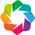

:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .Polygons.I :Polygons   [Longitude,Latitude]
      .Image.I    :Image   [Longitude,Latitude]   (Longitude_Latitude Count)

In [29]:
import colorcet as cc
import geoviews as gv
import holoviews.operation.datashader as hd

gv.extension("bokeh")
base_layer_hv = gv.tile_sources.EsriTerrain.opts(
    width=1200, height=750, bgcolor="black"
)
coastal_mask_hv = gv.Polygons(sp_coastal_mask_roi.geometry).opts(
    fill_color="gray", alpha=0.3, line_color=None
)
building_footprints_hv = hd.rasterize(gv.Polygons(sp_joined_roi.geometry)).opts(
    alpha=1, colorbar=True, clabel="Building footprint density", cmap=cc.fire
)
base_layer_hv * coastal_mask_hv * building_footprints_hv